## Interpreting the Patches

Validating the Assumptions of the Patch, and that the predicted performance beats make sense

In [3]:
import IPython.display as ipd
import numpy as np
import matplotlib.pyplot as plt
import utils
import librosa
import matplotlib.cm as cm

In [4]:
import mididiff
import pylcs

score_path = '/Users/aliamorsi/Downloads/tude_Op._100_No._10_Tender_Flower.mid'
perf_path = '/Users/aliamorsi/Documents/Yamaha Internship/burgmuller with no annotations/b-10-annot.mid'
score_beat_annotation_file = '/Users/aliamorsi/Documents/synthetic-mistake-study/piano-synmist/score_beat_annotations/b-10-score-beats-7-12.txt'

score_start = 8.333
score_end = 12.376
perf_start = 14.500
perf_end = 21.900

src_snippet = mididiff.snippet(score_start, score_end, score_path, score_beat_annotation_file)
tgt_snippet = mididiff.snippet(perf_start, perf_end, perf_path)

allnoteobjs = mididiff.diff_ms(src_snippet, tgt_snippet)

src charseq: mdkejfmrvdwctdrcphofphofmdkchdfcdack_
tgt charseq: dmekjfmrvdwctdrcphofphofkdmdkckdckhdcfdack_


In [5]:
aligned_score, aligned_perf, extra, missing, score_beattimes, perf_beattimes = mididiff.construct_midiroll(allnoteobjs, src_snippet, tgt_snippet)

In [33]:
missing_mask = np.ma.masked_where(missing > 1, missing)
extra_mask = np.ma.masked_where(extra > 1, extra)

In [6]:
np.ma.masked_where(missing <= 1, missing)

masked_array(
  data=[[--, --, --, ..., --, --, --],
        [--, --, --, ..., --, --, --],
        [--, --, --, ..., --, --, --],
        ...,
        [--, --, --, ..., --, --, --],
        [--, --, --, ..., --, --, --],
        [--, --, --, ..., --, --, --]],
  mask=[[ True,  True,  True, ...,  True,  True,  True],
        [ True,  True,  True, ...,  True,  True,  True],
        [ True,  True,  True, ...,  True,  True,  True],
        ...,
        [ True,  True,  True, ...,  True,  True,  True],
        [ True,  True,  True, ...,  True,  True,  True],
        [ True,  True,  True, ...,  True,  True,  True]],
  fill_value=1e+20)

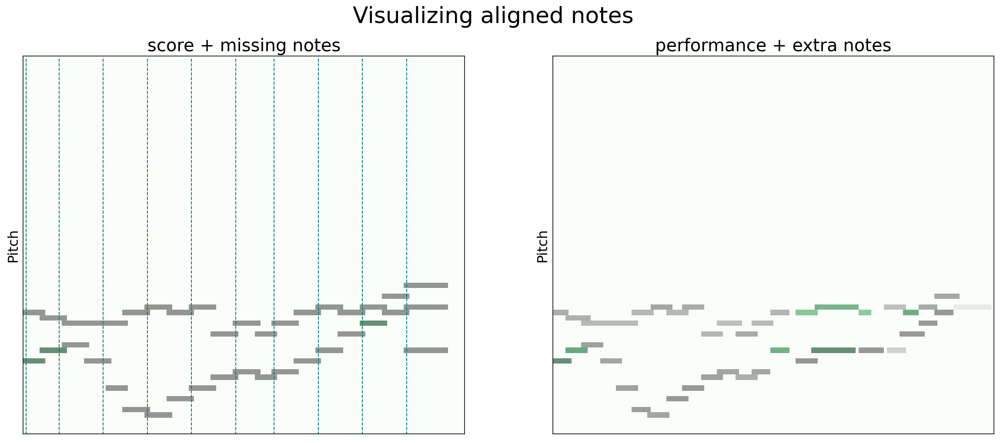

In [12]:
fig, ax = plt.subplots(1,2,figsize=(20, 8), sharey=True)
fig.suptitle('Visualizing aligned notes', fontsize=26)

#SCORE
ax[0].imshow(aligned_score[20:90,:], interpolation='none', cmap='Greys', aspect='auto')
ax[0].set_title('score + missing notes', fontsize=20)
ax[0].set_xticks([]); ax[0].set_yticks([])
ax[0].set_ylabel('Pitch', fontsize=16)
missing_masked = np.ma.masked_where(missing <= 1, missing).data
ax[0].imshow(missing_masked[20:90,:], interpolation='none', cmap='Greens', aspect='auto', alpha=0.6)
#if the beat lines look weird, extent can be used for scaling (extent = x.min(), x.max(), y.min(), y.max())
ax[0].vlines(x=score_beattimes, colors='teal', ymin=0, ymax=90, ls='--', lw=1, label='vline_multiple - full height')
   
#PERF
ax[1].imshow(aligned_perf[20:90,:], interpolation='none', cmap='Greys', aspect='auto')
ax[1].set_title('performance + extra notes', fontsize=20)
ax[1].set_xticks([]); ax[1].set_yticks([])
extra_masked = np.ma.masked_where(extra <= 1, extra).data
ax[1].imshow(extra_masked[20:90,:], interpolation='none', cmap='Greens', aspect='auto', alpha=0.6)
ax[1].set_ylabel('Pitch', fontsize=16)
ax[0].vlines(x=perf_beattimes, colors='teal', ymin=0, ymax=90, ls='--', lw=1, label='vline_multiple - full height')

In [1]:
## 1. Show the score portion in question (just using music21 or musicxml.. nothing interactive)

In [4]:
## This no longer holds because the perf beattime prediction thing is now gone.
## 2. Synthesize the audio, and put clicks in case of the score beats (annotated)
perf_audio = utils.synthesize_midi(perf_path) #todo: synthesize snippet, because this synthesizes the whole file. 

predicted_perf_beats = patch['nearest_perf_beattime'][patch['nearest_perf_beattime']>0]
y_beats_pred = librosa.clicks(times=predicted_perf_beats, sr=44100, click_freq=1000.0, 
                             click_duration=0.1, length=len(perf_audio))
#it's not a disaster! but I need to understand what happens with the calculation.

print('predicted beattime')
ipd.Audio(0.7*perf_audio+0.3*y_beats_pred, rate=44100) 

predicted beattime


In [4]:
## 3. Do the same but for the performance, using the patch. 
print('score annotation')
score_audio = utils.synthesize_midi(score_path)
score_annot_beats = patch['nearest_score_beattime'][patch['nearest_score_beattime']>0]
y_beats_annot = librosa.clicks(times=score_annot_beats, sr=44100, click_freq=1000.0, 
                             click_duration=0.1, length=len(score_audio))
ipd.Audio(0.7*score_audio+0.3*y_beats_annot, rate=44100) 

score annotation


### Visualizing the missing/extra notes

Reapplying the patch on a Score portion

In [ ]:
## Write the code that reapplies the patch somewhere 